In [2]:
import re, os
import json
import torch
import requests
import numpy    as np
import pandas   as pd
import seaborn  as sns
import matplotlib.pyplot   as plt
import tensorflow_datasets as tfds


from tqdm     import tqdm
from torch    import nn
from dotenv   import load_dotenv
from pathlib  import Path
from datasets import load_dataset
from transformers import AutoModel, AutoTokenizer, AutoModelForSequenceClassification

# NLP APIs
import nltk
from wordcloud   import WordCloud
from nltk.corpus import stopwords

In [2]:
# Load DATA_PATH from .env file
load_dotenv()
data_path  = os.getenv("DATA_PATH")
tweet_path = os.path.join(data_path, "text_emotion.csv")
# print(f"Tweet path: {tweet_path}")

In [3]:
# load the file
df_tweet = pd.read_csv(tweet_path, engine='python')
df_tweet.name = 'emotion tweets'

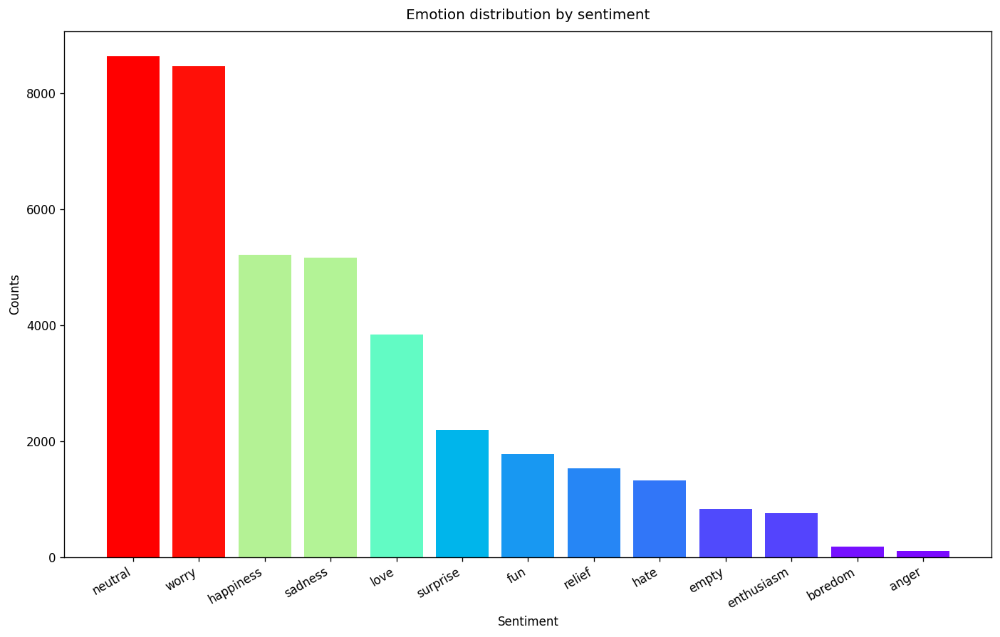

In [4]:
dist = df_tweet.groupby('sentiment')['tweet_id'].nunique()
dist = dist.sort_values(ascending=False)
cols = plt.cm.rainbow(dist.array/float(max(dist.array)))
plt.figure(figsize=(14, 8), dpi=120)
plt.bar(dist.index, dist.values, color=cols)
plt.xticks(rotation=30, ha='right')
plt.xlabel('Sentiment')
plt.ylabel('Counts')
plt.title('Emotion distribution by sentiment', pad=10.0)
plt.show()

In [5]:
# shorten function for lemmation
# can only handle one word at a time
# it will "purify" the tokens
lemmatizer = nltk.wordnet.WordNetLemmatizer()
lemma = lemmatizer.lemmatize

In [6]:
# generate wordclouds
emo_list = df_tweet.sentiment.unique()
cloud_list = []

for idx, i in enumerate(emo_list):
    tweet = df_tweet.content[df_tweet.sentiment.isin([i])].to_string()
    tweet = lemma(tweet)
    wordcloud = WordCloud(max_font_size=160, max_words=50,
                          width=1600, height=800,
                          colormap='plasma',
                          stopwords=stopwords.words('english'),
                          background_color="white").generate(tweet)
    cloud_list.append(wordcloud)

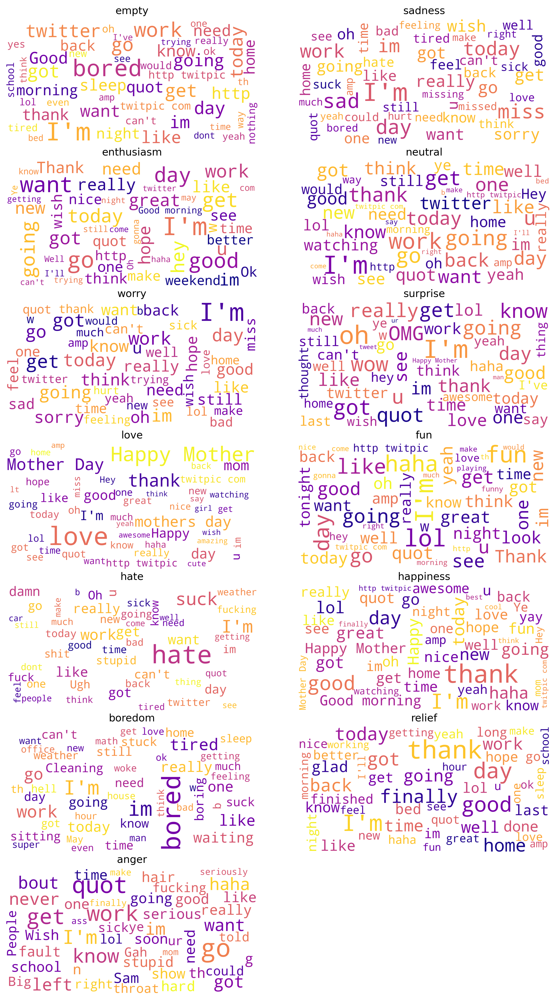

In [7]:
# plotting
fig = plt.figure(figsize=(10, 16), dpi=300)
plt.subplots_adjust(hspace=0.5)
for idx, cloud in enumerate(cloud_list):
    ax = plt.subplot(7, 2, idx+1)
    ax.imshow(cloud, interpolation="bilinear")
    ax.set_axis_off()
    ax.set_title(emo_list[idx])

plt.tight_layout(pad=.3)
plt.show()

In [8]:
# make queries to ConceptNet and returns related emotions or concepts
def query_conceptnet(keyword):
    url = f"http://api.conceptnet.io/c/en/{keyword}"
    response = requests.get(url)
    data = response.json()
    # Process the JSON data to extract relevant emotional associations
    emotions = []
    for edge in data.get("edges", []):
        if 'emotion' in edge['rel']['@id']:
            emotions.append(edge['end']['label'])
    return emotions

## GoEmotions dataset

In [11]:
# read all .csv files in a directory into one dataframe
def read_csvs_to_df(directory_path):
    dataframes = []
    dir_path = Path(directory_path)
    
    # Iterate over all csv files in the directory
    for csv_file in dir_path.glob('*.csv'):
        # Read the current csv into a DataFrame and append to the list
        dataframes.append(pd.read_csv(csv_file))
    
    # Concatenate all DataFrames into a single DataFrame
    concatenated_df = pd.concat(dataframes, ignore_index=True)
    
    # Return the concatenated DataFrame
    return concatenated_df


In [12]:
goemo_path = os.path.join(data_path, "goemotions")
df_goemo = read_csvs_to_df(goemo_path)

In [14]:
df_goemo[:5]

,text,id,author,subreddit,link_id,parent_id,created_utc,rater_id,example_very_unclear,admiration,...,love,nervousness,optimism,pride,realization,relief,remorse,sadness,surprise,neutral
0,That game hurt.,eew5j0j,Brdd9,nrl,t3_ajis4z,t1_eew18eq,1.548381e+09,1,False,0,...,0,0,0,0,0,0,0,1,0,0
1,>sexuality shouldn’t be a grouping category I...,eemcysk,TheGreen888,unpopularopinion,t3_ai4q37,t3_ai4q37,1.548084e+09,37,True,0,...,0,0,0,0,0,0,0,0,0,0
2,"You do right, if you don't care then fuck 'em!",ed2mah1,Labalool,confessions,t3_abru74,t1_ed2m7g7,1.546428e+09,37,False,0,...,0,0,0,0,0,0,0,0,0,1
3,Man I love reddit.,eeibobj,MrsRobertshaw,facepalm,t3_ahulml,t3_ahulml,1.547965e+09,18,False,0,...,1,0,0,0,0,0,0,0,0,0
4,"[NAME] was nowhere near them, he was by the Fa...",eda6yn6,American_Fascist713,starwarsspeculation,t3_ackt2f,t1_eda65q2,1.546669e+09,2,False,0,...,0,0,0,0,0,0,0,0,0,1


In [16]:
df_goemo.to_csv(path_or_buf='out.csv', index=False)

In [ ]:
# generate wordclouds
emo_list = df_goemo.sentiment.unique()
cloud_list = []

for idx, i in enumerate(emo_list):
    tweet = df_tweet.content[df_goemo.sentiment.isin([i])].to_string()
    tweet = lemma(tweet)
    wordcloud = WordCloud(max_font_size=160, max_words=50,
                          width=1600, height=800,
                          colormap='plasma',
                          stopwords=stopwords.words('english'),
                          background_color="white").generate(tweet)
    cloud_list.append(wordcloud)

In [9]:
# load the file
emo_words_path = os.path.join(data_path, "emotion_words.csv")
df_emo_words = pd.read_csv(emo_words_path, engine='python')
df_emo_words.name = 'GoEmotion words'

In [18]:
ls_emotions = df_emo_words.emotion.unique()
print(f"Emotions: {ls_emotions}")

Emotions: ['admiration' 'amusement' 'anger' 'annoyance' 'approval' 'caring'
 'confusion' 'curiosity' 'desire' 'disappointment' 'disapproval' 'disgust'
 'embarrassment' 'excitement' 'fear' 'gratitude' 'grief' 'joy' 'love'
 'nervousness' 'optimism' 'pride' 'realization' 'relief' 'remorse'
 'sadness' 'surprise' 'neutral']


**odds: The larger the magnitude (absolute value), the stronger the association with this group over the other emotions.**

In [39]:
fig = plt.figure(figsize=(30, 170), dpi=300)
fig.subplots_adjust(hspace=.5)

for idx, e in enumerate(ls_emotions):
    ax = plt.subplot(32, 1, idx + 1)
    ax.margins(x=-0.4) 

    emotion = df_emo_words.drop(df_emo_words[df_emo_words.emotion != e].index)

    # plotting
    cols = plt.cm.Purples(emotion['odds'].values/float(max(emotion['odds'].values)))
    plt.bar(emotion.word, emotion.odds, color=cols, alpha=.9)
    plt.title(e, fontdict={'fontsize':22})
    ax.set_xticks(emotion.word)
    ax.set_xticklabels(labels=emotion.word, rotation=75,fontdict={'fontsize':16})
    ax.set_ylabel('Odds')
    
    # a twin of the original axis to plot frequency
    ax2 = ax.twinx()
    ax2.plot(emotion.word, emotion.freq, color='r', marker='o', linestyle='none', alpha=.85)
    ax2.set_ylabel('Frequency', color='r')
    for label in ax2.get_yticklabels():
        label.set_color('r')

fig.suptitle('Emotion distribution by word', x=.5, y=.95, fontsize=26)
fig.tight_layout(pad=.3, rect=[0, .03, 1, .945])
plt.show()

**Top-5 words**

In [30]:
fig = plt.figure(figsize=(30, 85), dpi=200)
fig.subplots_adjust(hspace=.7)

for idx, e in enumerate(ls_emotions):
    ax = plt.subplot(15, 2, idx + 1)
    ax.margins(x=-0.4) 

    emotion = df_emo_words.drop(df_emo_words[df_emo_words.emotion != e].index)
    top_5   = emotion.sort_values(by='odds', ascending=False).head(5)

    # plotting
    cols = plt.cm.Purples(top_5['odds'].values/float(max(top_5['odds'].values)))
    # plt.bar(top_5.word, top_5.odds, color=cols, alpha=.9)
    # plt.title(e, fontdict={'fontsize':26})
    bars = ax.bar(top_5.word, top_5.odds, color=cols, alpha=.9)
    for bar in bars:
        yval = bar.get_height()
        ax.text(bar.get_x() + bar.get_width()/2, yval, round(yval, 2), 
                va='bottom', ha='center', fontsize=20)
    ax.legend([e], loc='upper right', fontsize=26)
    ax.set_xticks(top_5.word)
    ax.set_xticklabels(labels=top_5.word,fontdict={'fontsize':20})
    ax.set_ylabel('Odds', fontdict={'fontsize':20})
    ax.get_yaxis().set_visible(False)
    
    
    yticks = np.linspace(start=min(top_5.odds), stop=max(top_5.odds), num=len(top_5.odds))
    ax.set_yticks(yticks)
    ax.set_yticklabels(labels=['{:.2f}'.format(y) for y in yticks],fontdict={'fontsize':18})
    
    # a twin of the original axis to plot frequency
    ax2 = ax.twinx()
    ax2.plot(top_5.word, top_5.freq, color='r', marker='*', linestyle='none', 
             alpha=.7, markersize=20)
    yticks = np.linspace(start=min(top_5.freq), stop=max(top_5.freq), num=5)
    ax2.set_yticks(yticks)
    ax2.set_yticklabels(labels=['{:.4f}'.format(y) for y in yticks], fontdict={'fontsize':18})
    ax2.set_ylabel('Frequency', color='r', fontdict={'fontsize':20})
    for label in ax2.get_yticklabels():
        label.set_color('r')

fig.suptitle('Top-5 word for each emotion', x=.5, y=.95, fontsize=28)
fig.tight_layout(pad=.3, rect=[0, .03, 1, .945])
plt.show()

## How is CEBabB?

In [3]:
CEBaB = load_dataset("CEBaB/CEBaB")

In [4]:
df_CEBaB = CEBaB['train_exclusive'].to_pandas()

In [36]:
df_CEBaB.columns

Index(['id', 'original_id', 'edit_id', 'is_original', 'edit_goal', 'edit_type',
       'edit_worker', 'description', 'review_majority',
       'review_label_distribution', 'review_workers', 'food_aspect_majority',
       'ambiance_aspect_majority', 'service_aspect_majority',
       'noise_aspect_majority', 'food_aspect_label_distribution',
       'ambiance_aspect_label_distribution',
       'service_aspect_label_distribution', 'noise_aspect_label_distribution',
       'food_aspect_validation_workers', 'ambiance_aspect_validation_workers',
       'service_aspect_validation_workers', 'noise_aspect_validation_workers',
       'opentable_metadata'],
      dtype='object')

In [5]:
df_CEBaB_concept = df_CEBaB.loc[:, ["food_aspect_majority", "service_aspect_majority","ambiance_aspect_majority","noise_aspect_majority"]]


In [6]:
df_CEBaB_train = df_CEBaB.loc[:, ["review_majority", "description"]]

In [7]:
# Load the BERTweet model and tokenizer
bertweet = AutoModel.from_pretrained("vinai/bertweet-base")
tokenizer = AutoTokenizer.from_pretrained("vinai/bertweet-base", use_fast=False)


In [8]:
bertweet.eval()
torch.use_deterministic_algorithms(True)

In [9]:
input = torch.tensor([tokenizer.encode(df_CEBaB['description'][2])])

In [12]:
# Forward pass through the model
with torch.no_grad():  # No need to compute gradients for prediction
    outputs = bertweet(input)
print(outputs)

BaseModelOutputWithPoolingAndCrossAttentions(last_hidden_state=tensor([[[-0.0022,  0.1469, -0.0007,  ..., -0.0670, -0.0391,  0.1145],
         [ 0.3453,  0.5387, -0.0626,  ..., -0.2367,  0.0553, -0.0580],
         [ 0.1291, -0.1135,  0.0804,  ...,  0.2877, -0.5772, -0.1508],
         ...,
         [-0.4356, -0.0169,  0.1705,  ..., -0.1775,  0.6676,  0.2266],
         [ 0.1929, -0.1609,  0.0317,  ...,  0.2206, -0.5964, -0.2262],
         [-0.0265,  0.1521, -0.0050,  ..., -0.0891, -0.0023,  0.1279]]]), pooler_output=tensor([[ 1.7290e-01, -1.7220e-01,  5.8083e-02, -1.8109e-01,  1.4008e-01,
         -1.1086e-01,  1.1116e-01, -1.0573e-01,  1.3314e-01, -1.5027e-01,
         -4.2422e-02, -1.3207e-01, -2.0841e-01,  8.6443e-02,  1.8791e-01,
         -7.6985e-02, -2.1169e-01, -8.6724e-02,  2.7768e-02,  9.0975e-03,
         -1.1248e-01, -1.7053e-01,  3.6310e-01, -5.9584e-02, -1.0786e-02,
          1.3044e-01, -2.0819e-01, -1.9398e-02,  8.6687e-02,  1.1872e-02,
         -2.7733e-02, -2.2750e-01,  

In [13]:
class BertweetClassifier(nn.Module):
    def __init__(self, bertweet_model, num_labels):
        super(BertweetClassifier, self).__init__()
        self.bertweet = bertweet_model
        # Add a dropout layer for some regularization
        # self.dropout = nn.Dropout(0.1)
        # Add a Linear layer for classification
        self.classifier = nn.Linear(self.bertweet.config.hidden_size, 
                                    num_labels)

    def forward(self, input_ids, attention_mask=None):
        # Get the last hidden state of the token `[CLS]` for classification task
        outputs = self.bertweet(input_ids=input_ids, attention_mask=attention_mask)
        pooled_output = outputs.pooler_output
        # pooled_output = self.dropout(pooled_output)
        logits = self.classifier(pooled_output)
        return logits

In [21]:
# Instantiate the classifier with the number of labels for classification task
num_labels = len(["1", "2", "3", "4", "5"]) 
model = BertweetClassifier(bertweet, num_labels=num_labels)
model.eval()

logits = model(input)

# Convert logits to probabilities
probabilities = torch.softmax(logits, dim=-1)
_, prediction = torch.max(probabilities, dim=1)

print(prediction.item()+ 1 )

1


In [67]:
print(df_CEBaB['description'][2])

Good food but service needs some tweaking. Good drink deals and appetizer deals. Quiet and intimate.


## Adjustment of the Goemotion dataset

In [69]:
df_goemo.columns

Index(['text', 'id', 'author', 'subreddit', 'link_id', 'parent_id',
       'created_utc', 'rater_id', 'example_very_unclear', 'admiration',
       'amusement', 'anger', 'annoyance', 'approval', 'caring', 'confusion',
       'curiosity', 'desire', 'disappointment', 'disapproval', 'disgust',
       'embarrassment', 'excitement', 'fear', 'gratitude', 'grief', 'joy',
       'love', 'nervousness', 'optimism', 'pride', 'realization', 'relief',
       'remorse', 'sadness', 'surprise', 'neutral'],
      dtype='object')

In [73]:
df_new_goemo = df_goemo.loc[:,['text','admiration','amusement', 'anger', 'annoyance', 
                        'approval', 'caring', 'confusion', 'curiosity', 'desire', 
                        'disappointment', 'disapproval', 'disgust', 'embarrassment', 
                        'excitement', 'fear', 'gratitude', 'grief', 'joy', 'love', 
                        'nervousness', 'optimism', 'pride', 'realization', 'relief',
                        'remorse', 'sadness', 'surprise', 'neutral']]

In [74]:
mapping_dict = {1: 'Positive', 0: 'unknown'}

for col in df_new_goemo.columns:
    if col != 'text':
        df_new_goemo[col] = df_new_goemo[col].map(mapping_dict)

In [127]:
class BertweetClassifier(nn.Module):
    def __init__(self, bertweet_model):
        super(BertweetClassifier, self).__init__()
        self.bertweet = bertweet_model
        self.dropout = nn.Dropout(0.1)
        self.classifier = nn.Linear(self.bertweet.config.hidden_size, 
                                    5)

    def forward(self, input_ids, attention_mask=None):
        outputs = self.bertweet(input_ids=input_ids, attention_mask=attention_mask)
        pooled_output = outputs.pooler_output
        pooled_output = self.dropout(pooled_output)
        logits = self.classifier(pooled_output)
        return logits


In [172]:
# Load the BERTweet model and tokenizer
tokenizer = AutoTokenizer.from_pretrained("vinai/bertweet-base", use_fast=False)
model = BertweetClassifier(bertweet)

# Function to predict sentiment
def predict_sentiment(text, model, tokenizer):
    model.eval()
    input = tokenizer(text, return_tensors="pt", padding="max_length", truncation=True, max_length=512)
    input.pop('token_type_ids', None)
    with torch.no_grad():
        logits = model(**input)  # Get logits from the model
        probabilities = torch.softmax(logits, dim=-1)
        
        # print(f"Logits: {logits}")
        # print(f"Probabilities: {probabilities}")
            
    prediction = torch.argmax(probabilities, dim=-1)  # Get the index of the highest probability
    return prediction.item()

In [160]:
print(predict_sentiment(df_new_goemo['text'][0], model, tokenizer))

Logits: tensor([[ 0.2395, -0.1274, -0.1483, -0.0662, -0.0416]])
Probabilities: tensor([[0.2589, 0.1794, 0.1757, 0.1907, 0.1954]])
0


In [159]:
print(predict_sentiment(df_new_goemo['text'][3], model, tokenizer))

Logits: tensor([[ 0.2322, -0.1096, -0.1236, -0.0904, -0.0328]])
Probabilities: tensor([[0.2562, 0.1821, 0.1795, 0.1856, 0.1966]])
0


In [163]:
print(predict_sentiment(df_new_goemo['text'][66], model, tokenizer))

Logits: tensor([[ 0.2073, -0.1158, -0.1291, -0.1103, -0.0183]])
Probabilities: tensor([[0.2523, 0.1826, 0.1802, 0.1836, 0.2013]])
0


In [165]:
print(predict_sentiment(df_new_goemo['text'][69], model, tokenizer))

Logits: tensor([[ 0.2735, -0.0991, -0.1181, -0.0741, -0.0414]])
Probabilities: tensor([[0.2631, 0.1812, 0.1778, 0.1858, 0.1920]])
0


In [167]:
# Predict sentiment for each row in the DataFrame and store it in a new column
df_new_goemo['predicted_sentiment'] = df_new_goemo['text'].apply(lambda x: predict_sentiment(x, model, tokenizer))

Logits: tensor([[ 0.2395, -0.1274, -0.1483, -0.0662, -0.0416]])
Probabilities: tensor([[0.2589, 0.1794, 0.1757, 0.1907, 0.1954]])
Logits: tensor([[ 0.2628, -0.0842, -0.1098, -0.0921, -0.0429]])
Probabilities: tensor([[0.2609, 0.1844, 0.1797, 0.1829, 0.1921]])
Logits: tensor([[ 0.1879, -0.1305, -0.1344, -0.1047, -0.0536]])
Probabilities: tensor([[0.2510, 0.1826, 0.1819, 0.1874, 0.1972]])
Logits: tensor([[ 0.2322, -0.1096, -0.1236, -0.0904, -0.0328]])
Probabilities: tensor([[0.2562, 0.1821, 0.1795, 0.1856, 0.1966]])
Logits: tensor([[ 0.2122, -0.0530, -0.1329, -0.0808,  0.0110]])
Probabilities: tensor([[0.2476, 0.1899, 0.1753, 0.1847, 0.2025]])
Logits: tensor([[ 0.1895, -0.0561, -0.1391, -0.0741, -0.0484]])
Probabilities: tensor([[0.2464, 0.1927, 0.1774, 0.1893, 0.1942]])
Logits: tensor([[ 0.1907, -0.0682, -0.1706, -0.0890,  0.0471]])
Probabilities: tensor([[0.2444, 0.1887, 0.1703, 0.1848, 0.2117]])
Logits: tensor([[ 0.2526, -0.0577, -0.1685, -0.0854, -0.0474]])
Probabilities: tensor([[0.

RuntimeError: The expanded size of the tensor (213) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 213].  Tensor sizes: [1, 130]

In [174]:
predicted_sentiments = []
for text in tqdm(df_new_goemo['text'], desc="Predicting sentiment"):
    try:
        sentiment = predict_sentiment(text, model, tokenizer)
    except RuntimeError as e:
        print(f"RuntimeError: {e}")
        sentiment = None
    predicted_sentiments.append(sentiment)

df_new_goemo['predicted_sentiment'] = predicted_sentiments

Predicting sentiment:   0%|          | 28/211225 [00:00<25:32, 137.85it/s]

RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
Runt

Predicting sentiment:   0%|          | 42/211225 [00:00<25:44, 136.73it/s]

RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
Runt

Predicting sentiment:   0%|          | 70/211225 [00:00<26:47, 131.38it/s]

RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
Runt

Predicting sentiment:   0%|          | 100/211225 [00:00<25:25, 138.36it/s]

RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
Runt

Predicting sentiment:   0%|          | 129/211225 [00:00<25:23, 138.59it/s]

RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
Runt

Predicting sentiment:   0%|          | 159/211225 [00:01<25:04, 140.29it/s]

RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
Runt

Predicting sentiment:   0%|          | 189/211225 [00:01<29:23, 119.68it/s]

RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
Runt

Predicting sentiment:   0%|          | 204/211225 [00:01<27:55, 125.96it/s]

RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
Runt

Predicting sentiment:   0%|          | 234/211225 [00:01<26:13, 134.11it/s]

RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
Runt

Predicting sentiment:   0%|          | 263/211225 [00:01<25:53, 135.84it/s]

RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
Runt

Predicting sentiment:   0%|          | 292/211225 [00:02<27:34, 127.48it/s]

RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
Runt

Predicting sentiment:   0%|          | 322/211225 [00:02<26:03, 134.85it/s]

RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
Runt

Predicting sentiment:   0%|          | 352/211225 [00:02<25:22, 138.54it/s]

RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
Runt

Predicting sentiment:   0%|          | 381/211225 [00:02<25:12, 139.44it/s]

RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
Runt

Predicting sentiment:   0%|          | 409/211225 [00:03<26:13, 133.99it/s]

RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
Runt

Predicting sentiment:   0%|          | 437/211225 [00:03<27:15, 128.91it/s]

RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
Runt

Predicting sentiment:   0%|          | 463/211225 [00:03<27:30, 127.69it/s]

RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
Runt

Predicting sentiment:   0%|          | 492/211225 [00:03<26:09, 134.29it/s]

RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
Runt

Predicting sentiment:   0%|          | 507/211225 [00:03<25:46, 136.27it/s]

RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
Runt

Predicting sentiment:   0%|          | 535/211225 [00:04<26:49, 130.88it/s]

RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
Runt

Predicting sentiment:   0%|          | 565/211225 [00:04<25:40, 136.79it/s]

RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
Runt

Predicting sentiment:   0%|          | 595/211225 [00:04<24:55, 140.85it/s]

RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
Runt

Predicting sentiment:   0%|          | 625/211225 [00:04<25:59, 135.01it/s]

RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
Runt

Predicting sentiment:   0%|          | 655/211225 [00:04<25:11, 139.28it/s]

RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
Runt

Predicting sentiment:   0%|          | 685/211225 [00:05<24:43, 141.91it/s]

RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
Runt

Predicting sentiment:   0%|          | 715/211225 [00:05<24:35, 142.71it/s]

RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
Runt

Predicting sentiment:   0%|          | 730/211225 [00:05<30:37, 114.57it/s]

RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
Runt

Predicting sentiment:   0%|          | 758/211225 [00:05<28:43, 122.12it/s]

RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
Runt

Predicting sentiment:   0%|          | 788/211225 [00:05<26:34, 131.96it/s]

RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
Runt

Predicting sentiment:   0%|          | 818/211225 [00:06<25:27, 137.74it/s]

RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
Runt

Predicting sentiment:   0%|          | 846/211225 [00:06<27:18, 128.38it/s]

RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
Runt

Predicting sentiment:   0%|          | 876/211225 [00:06<25:56, 135.11it/s]

RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
Runt

Predicting sentiment:   0%|          | 906/211225 [00:06<25:15, 138.73it/s]

RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
Runt

Predicting sentiment:   0%|          | 920/211225 [00:06<27:47, 126.10it/s]

RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
Runt

Predicting sentiment:   0%|          | 946/211225 [00:07<28:53, 121.31it/s]

RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
Runt

Predicting sentiment:   0%|          | 976/211225 [00:07<26:40, 131.33it/s]

RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
Runt

Predicting sentiment:   0%|          | 1005/211225 [00:07<26:24, 132.67it/s]

RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
Runt

Predicting sentiment:   0%|          | 1033/211225 [00:07<26:20, 132.98it/s]

RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
Runt

Predicting sentiment:   1%|          | 1060/211225 [00:07<27:45, 126.21it/s]

RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
Runt

Predicting sentiment:   1%|          | 1090/211225 [00:08<26:06, 134.10it/s]

RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
Runt

Predicting sentiment:   1%|          | 1104/211225 [00:08<26:22, 132.75it/s]

RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
Runt

Predicting sentiment:   1%|          | 1133/211225 [00:08<25:36, 136.77it/s]

RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
Runt

Predicting sentiment:   1%|          | 1162/211225 [00:08<26:33, 131.82it/s]

RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
Runt

Predicting sentiment:   1%|          | 1190/211225 [00:08<25:55, 135.05it/s]

RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
Runt

Predicting sentiment:   1%|          | 1218/211225 [00:09<25:28, 137.36it/s]

RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
Runt

Predicting sentiment:   1%|          | 1248/211225 [00:09<24:56, 140.35it/s]

RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
Runt

Predicting sentiment:   1%|          | 1278/211225 [00:09<29:19, 119.30it/s]

RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
Runt

Predicting sentiment:   1%|          | 1306/211225 [00:09<27:16, 128.28it/s]

RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
Runt

Predicting sentiment:   1%|          | 1335/211225 [00:10<26:01, 134.41it/s]

RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
Runt

Predicting sentiment:   1%|          | 1364/211225 [00:10<25:29, 137.22it/s]

RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
Runt

Predicting sentiment:   1%|          | 1378/211225 [00:10<27:31, 127.10it/s]

RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
Runt

Predicting sentiment:   1%|          | 1393/211225 [00:10<26:19, 132.85it/s]


RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]
RuntimeError: The expanded size of the tensor (512) must match the existing size (130) at non-singleton dimension 1.  Target sizes: [1, 512].  Tensor sizes: [1, 130]


KeyboardInterrupt: 